# Replikasi jurnal "Pre-trained CNNs Models for Content based Image Retrieval"
### DOI: 10.14569/IJACSA.2021.0120723




## Import Library & Setup Environment

In [1]:
# Standard Libraries
import os
import sys
import numpy as np
import pandas as pd
import time

# Progress Bar & Visualization
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython.display import display
import matplotlib.patches as patches

# Image Processing
import cv2
from PIL import Image

# Machine Learning & Similarity
import faiss
from sklearn.preprocessing import normalize
from sklearn.metrics.pairwise import cosine_similarity

# Deep Learning (PyTorch)
import torch
from torchvision import models, transforms


# Setup Environment
data_dir = "D:\\Trade-Off_CBIR\\dataset\\Corel-1K"
data_dir_GHIM = "D:\\Trade-Off_CBIR\\dataset\\GHIM-10K"

print("Classes available:", os.listdir(data_dir))
print("Classes available:", os.listdir(data_dir_GHIM))

# Device Setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Classes available: ['africans', 'beaches', 'buildings', 'buses', 'dinosaurs', 'elephants', 'flowers', 'food', 'horses', 'mountains']
Classes available: ['aircraft', 'buildings', 'butterfly', 'cars', 'dragon fly', 'fireworks', 'flowers', 'hen', 'horses', 'insects', 'motorcycles', 'mountains', 'sea shores', 'ships', 'sunset', 'temples', 'trees', 'valleys', 'walls', 'yacht']
Using device: cuda


# A. Dataset Corel-1K

## Tahap 1: Ekstraksi Fitur Menggunakan Deskriptor Tradisional (Color Layout & GLCM) dan Model CNN Pre-trained (SqueezeNet & ResNet18)

In [24]:
import os
import cv2
import time
import torch
import numpy as np
from PIL import Image
import pandas as pd
from tqdm import tqdm
from torchvision import models, transforms
from sklearn.metrics.pairwise import cosine_similarity

# ===============================================================
# SETUP
# ===============================================================

data_dir = "D:\\Trade-Off_CBIR\\dataset\\Corel-1K"

img_paths = []
labels = []

for cls in os.listdir(data_dir):
    cls_path = os.path.join(data_dir, cls)
    for f in os.listdir(cls_path):
        img_paths.append(os.path.join(cls_path, f))
        labels.append(cls)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [25]:
# 1. GLCM Custom
def extract_glcm_features(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (64,64))
    img = (img / 32).astype(np.uint8)
    levels = 8
    glcm = np.zeros((levels, levels), dtype=np.float32)

    for i in range(img.shape[0]):
        for j in range(img.shape[1]-1):
            glcm[img[i,j], img[i,j+1]] += 1

    glcm = glcm / np.sum(glcm)

    contrast = np.sum(glcm * (np.arange(levels).reshape(-1,1) - np.arange(levels).reshape(1,-1))**2)
    energy = np.sum(glcm**2)
    homogeneity = np.sum(glcm / (1.0 + np.abs(np.arange(levels).reshape(-1,1) - np.arange(levels).reshape(1,-1))))
    correlation = 0

    return np.array([contrast, energy, homogeneity, correlation])

# 2. Color Layout
def extract_color_layout(img_path):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (64,64))
    return img.mean(axis=(0,1))

# 3. CNN Feature Extractor
def extract_cnn_features(model, img_path, transform):
    img = Image.open(img_path).convert("RGB")
    img_t = transform(img).unsqueeze(0).to(device)

    with torch.no_grad():
        feats = model(img_t)
        if isinstance(feats, torch.Tensor):
            feats = feats
        else:
            feats = feats[0]
        feats = feats.cpu().numpy().flatten()

    return feats

# CNN Models
squeezenet = models.squeezenet1_1(pretrained=True).to(device).eval()
resnet18 = models.resnet18(pretrained=True).to(device).eval()

# Replace final FC layer for pure embeddings
resnet18.fc = torch.nn.Identity()

transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

In [26]:
def measure_inference_speed(model, sample_img, transform, device='cuda'):
    img_t = transform(sample_img).unsqueeze(0).to(device)

    torch.cuda.synchronize() if device == 'cuda' else None
    start = time.time()

    with torch.no_grad():
        if hasattr(model, 'features'):  
            # SqueezeNet
            x = model.features(img_t)
            x = torch.nn.functional.adaptive_avg_pool2d(x, 1)
            _ = torch.flatten(x, 1)
        elif hasattr(model, 'fc'):       
            _ = model(img_t)             # ResNet18
        else:
            _ = model(img_t)

    torch.cuda.synchronize() if device == 'cuda' else None
    return time.time() - start


# ===============================================================
# EMBEDDING METRICS
# ===============================================================

def measure_embedding_metrics(features, labels):
    start = time.time()
    sims = cosine_similarity(features, features)
    search_time = time.time() - start

    inter_dists = []
    classes = list(set(labels))

    # Inter-class
    for i, cls_i in enumerate(classes):
        idx_i = [k for k, l in enumerate(labels) if l == cls_i]
        for j, cls_j in enumerate(classes):
            if i >= j:
                continue
            idx_j = [k for k, l in enumerate(labels) if l == cls_j]
            inter_dists.append(np.mean(sims[np.ix_(idx_i, idx_j)]))

    # Intra-class
    intra_dists = []
    for cls in classes:
        idx = [k for k,l in enumerate(labels) if l == cls]
        intra_dists.append(np.mean(sims[np.ix_(idx, idx)]))

    return search_time, np.mean(inter_dists), np.mean(intra_dists)


# ===============================================================
# EXTRACT ALL FEATURES
# ===============================================================

glcm_features = []
color_features = []
squeeze_features = []
resnet_features = []

for path in tqdm(img_paths, desc="Extracting Features"):
    glcm_features.append(extract_glcm_features(path))
    color_features.append(extract_color_layout(path))
    squeeze_features.append(extract_cnn_features(squeezenet, path, transform))
    resnet_features.append(extract_cnn_features(resnet18, path, transform))

glcm_features = np.array(glcm_features)
color_features = np.array(color_features)
squeeze_features = np.array(squeeze_features)
resnet_features = np.array(resnet_features)

# ===============================================================
# RUN METRICS (FULL)
# ===============================================================

sample_img = Image.open(img_paths[0]).convert("RGB")

sq_time = measure_inference_speed(squeezenet, sample_img, transform, str(device))
rn_time = measure_inference_speed(resnet18, sample_img, transform, str(device))

glcm_time = measure_inference_speed(lambda x: None, sample_img, transform)  # trivial surrogate
color_time = glcm_time

glcm_search, glcm_inter, glcm_intra = measure_embedding_metrics(glcm_features, labels)
color_search, color_inter, color_intra = measure_embedding_metrics(color_features, labels)
sq_search, sq_inter, sq_intra = measure_embedding_metrics(squeeze_features, labels)
rn_search, rn_inter, rn_intra = measure_embedding_metrics(resnet_features, labels)

Extracting Features: 100%|██████████| 1000/1000 [00:49<00:00, 20.40it/s]


In [27]:
df_metrics = pd.DataFrame({
    "Model": ["GLCM", "Color Layout", "SqueezeNet", "ResNet18"],
    "Inference speed (s/img)": [glcm_time, color_time, sq_time, rn_time],
    "Embedding search time (s)": [glcm_search, color_search, sq_search, rn_search],
    "Inter-class dist": [glcm_inter, color_inter, sq_inter, rn_inter],
    "Intra-class dist": [glcm_intra, color_intra, sq_intra, rn_intra]
})

display(df_metrics)

,Model,Inference speed (s/img),Embedding search time (s),Inter-class dist,Intra-class dist
0,GLCM,0.001008,0.013340,0.917054,0.961617
1,Color Layout,0.001008,0.009073,0.968826,0.988100
2,SqueezeNet,0.005321,0.057439,0.837881,0.946956
3,ResNet18,0.010010,0.010546,0.540807,0.741770


## Tahap 2: Pre-trained Models

### 1. SqueezeNet – Pre-trained CNNs for Features Extraction

In [ ]:
img_paths = []
labels = []

for cls in os.listdir(data_dir):
    cls_path = os.path.join(data_dir, cls)
    for f in os.listdir(cls_path):
        img_paths.append(os.path.join(cls_path, f))
        labels.append(cls)

squeezenet_features = []

# Ekstraksi fitur SqueezeNet
for path in tqdm(img_paths, desc="Extracting SqueezeNet Features"):
    img = Image.open(path).convert('RGB')
    img_t = transform(img).unsqueeze(0).to(device) # type: ignore

    with torch.no_grad():
        sq_feat = squeezenet.features(img_t)
        sq_feat = torch.flatten(sq_feat, 1)
        squeezenet_features.append(sq_feat.squeeze().cpu().numpy())

squeezenet_features = np.array(squeezenet_features)

Extracting SqueezeNet Features: 100%|██████████| 1000/1000 [00:12<00:00, 77.15it/s]


### 2. ResNet18 – Pre-trained CNNs for Feature Extraction

In [11]:
resnet18_features = []

# Ekstraksi fitur ResNet18
for path in tqdm(img_paths, desc="Extracting ResNet18 Features"):
    img = Image.open(path).convert('RGB')
    img_t = transform(img).unsqueeze(0).to(device) # type: ignore

    with torch.no_grad():
        x = resnet18.conv1(img_t)
        x = resnet18.bn1(x)
        x = resnet18.relu(x)
        x = resnet18.maxpool(x)
        x = resnet18.layer1(x)
        x = resnet18.layer2(x)
        x = resnet18.layer3(x)
        x = resnet18.layer4(x)
        x = resnet18.avgpool(x)        # 512-dim feature
        resnet18_features.append(x.squeeze().cpu().numpy())

resnet18_features = np.array(resnet18_features)

Extracting ResNet18 Features: 100%|██████████| 1000/1000 [00:12<00:00, 79.81it/s]


### 3. Visual Features – Color Layout (CL) & GLCM Texture Descriptors

In [12]:
cl_features = []
glcm_features = []

# Ekstraksi fitur CL & GLCM
for path in tqdm(img_paths, desc="Extracting CL & GLCM Features"):
    # Color Layout
    cl_features.append(extract_color_layout(path))
    # GLCM Texture Features
    glcm_features.append(extract_glcm_features(path))

cl_features = np.array(cl_features)
glcm_features = np.array(glcm_features)


Extracting CL & GLCM Features: 100%|██████████| 1000/1000 [00:28<00:00, 34.66it/s]


## Tahap 3: Image Retrieval & Similarity Matching

In [ ]:
# Retrieve indeks gambar paling mirip berdasarkan cosine similarity.
def retrieve(query_feat, all_feats, top_k=10):
    sims = cosine_similarity([query_feat], all_feats)[0] # type: ignore
    idxs = np.argsort(sims)[::-1][:top_k]
    return idxs

def evaluate_recall_precision(features, labels, top_k=10):
    classes = sorted(list(set(labels)))
    results = []
    for cls in classes:
        idxs_cls = [i for i,l in enumerate(labels) if l==cls]
        R_list, P_list = [], []
        for q in idxs_cls:
            retrieved_idx = retrieve(features[q], features, top_k)
            retrieved_labels = [labels[i] for i in retrieved_idx]
            R = retrieved_labels.count(cls) / len(idxs_cls)
            P = retrieved_labels.count(cls) / top_k
            R_list.append(R)
            P_list.append(P)
        results.append([cls, np.mean(R_list), np.mean(P_list)])
    return pd.DataFrame(results, columns=['Class','R','P'])

## Tahap 4: Evaluasi

In [14]:
df_cl_glcm = evaluate_recall_precision(np.hstack([cl_features, glcm_features]), labels)
df_squeeze = evaluate_recall_precision(squeezenet_features, labels)
df_resnet = evaluate_recall_precision(resnet18_features, labels)

df_table = pd.DataFrame()
df_table['Class'] = df_cl_glcm['Class']

df_table['CL&GLCM R'] = df_cl_glcm['R']
df_table['CL&GLCM P'] = df_cl_glcm['P']

df_table['SqueezeNet R'] = df_squeeze['R']
df_table['SqueezeNet P'] = df_squeeze['P']

df_table['ResNet18 R'] = df_resnet['R']
df_table['ResNet18 P'] = df_resnet['P']

# MEAN
mean_row = {
    'Class': 'Mean',
    'CL&GLCM R': df_cl_glcm['R'].mean(),
    'CL&GLCM P': df_cl_glcm['P'].mean(),
    'SqueezeNet R': df_squeeze['R'].mean(),
    'SqueezeNet P': df_squeeze['P'].mean(),
    'ResNet18 R': df_resnet['R'].mean(),
    'ResNet18 P': df_resnet['P'].mean(),
}

df_table = pd.concat([df_table, pd.DataFrame([mean_row])], ignore_index=True)

for col in df_table.columns[1:]:
    df_table[col] = df_table[col].astype(float).map("{:.4f}".format)

display(df_table)

,Class,CL&GLCM R,CL&GLCM P,SqueezeNet R,SqueezeNet P,ResNet18 R,ResNet18 P
0,africans,0.0442,0.4420,0.0630,0.6300,0.0904,0.9040
1,beaches,0.0369,0.3690,0.0522,0.5220,0.0897,0.8970
2,buildings,0.0289,0.2890,0.0786,0.7860,0.0943,0.9430
3,buses,0.0405,0.4050,0.1000,1.0000,0.1000,1.0000
4,dinosaurs,0.0846,0.8460,0.0993,0.9930,0.1000,1.0000
5,elephants,0.0314,0.3140,0.0898,0.8980,0.1000,1.0000
6,flowers,0.0614,0.6140,0.0997,0.9970,0.0999,0.9990
7,food,0.0521,0.5210,0.0760,0.7600,0.0975,0.9750
8,horses,0.0858,0.8580,0.0964,0.9640,0.0994,0.9940
9,mountains,0.0391,0.3910,0.0903,0.9030,0.0950,0.9500


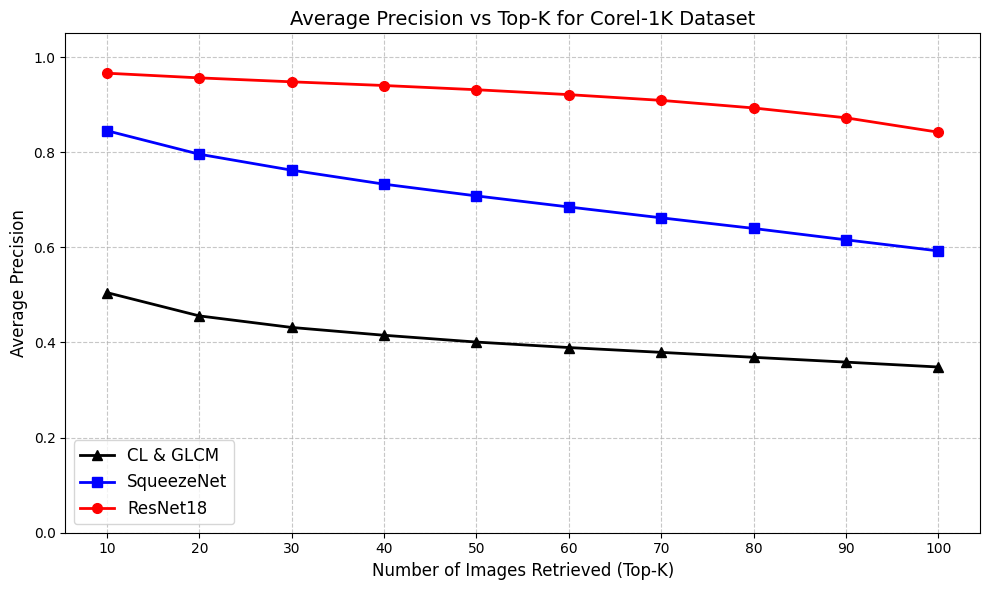

In [15]:
def average_precision_vs_topk(features_list, labels, top_k_max=100):
    top_ks = list(range(10, top_k_max + 1, 10))
    avg_prec = {name: [] for name in features_list}

    for top_k in top_ks:
        for name, feats in features_list.items():
            df = evaluate_recall_precision(feats, labels, top_k=top_k)
            avg_prec[name].append(df['P'].mean())

    plt.figure(figsize=(10, 6))

    markers = {
        'ResNet18': 'o',
        'SqueezeNet': 's',
        'CL & GLCM': '^'
    }

    colors = {
        'ResNet18': 'red',
        'SqueezeNet': 'blue',
        'CL & GLCM': 'black'
    }

    for name in features_list:
        plt.plot(top_ks, avg_prec[name],
                 marker=markers[name],
                 color=colors[name],
                 linestyle='-',
                 linewidth=2,
                 markersize=7,
                 label=name)

    plt.xlabel("Number of Images Retrieved (Top-K)", fontsize=12)
    plt.ylabel("Average Precision", fontsize=12)
    plt.title("Average Precision vs Top-K for Corel-1K Dataset", fontsize=14)
    plt.xticks(top_ks)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12)
    plt.ylim(0, 1.05)
    plt.tight_layout()
    plt.show()


# Dictionary fitur
features_dict = {
    'CL & GLCM': np.hstack([cl_features, glcm_features]),
    'SqueezeNet': squeezenet_features,
    'ResNet18': resnet18_features
}

average_precision_vs_topk(features_dict, labels, top_k_max=100)

In [22]:
def show_topk_per_class(features, labels, img_paths, top_k=4):
    classes = sorted(list(set(labels)))

    for cls in classes:
        print(f"\n=== Class: {cls} ===")

        # Mengambil index pertama dari kelas sebagai query
        query_idx = labels.index(cls)

        # Retrieve top-k hasil
        retrieved_idx = retrieve(features[query_idx], features, top_k)

        plt.figure(figsize=(15, 3))
        plt.suptitle(f"Query Class: {cls}", fontsize=14)

        query_img = Image.open(img_paths[query_idx])
        plt.subplot(1, top_k + 1, 1)
        plt.imshow(query_img)
        plt.axis('off')
        plt.title("Query", fontsize=10)
        plt.gca().add_patch(patches.Rectangle((0,0), query_img.width, query_img.height,
                                              edgecolor='blue', fill=False, linewidth=3))

        for i, idx in enumerate(retrieved_idx):
            img = Image.open(img_paths[idx])
            plt.subplot(1, top_k + 1, i + 2)
            plt.imshow(img)
            plt.axis('off')
            color = 'green' if labels[idx] == cls else 'red'
            plt.gca().add_patch(patches.Rectangle((0,0), img.width, img.height,
                                                  edgecolor=color, fill=False, linewidth=3))
            plt.title(labels[idx], fontsize=9)

        plt.tight_layout()
        plt.show()



=== Class: africans ===


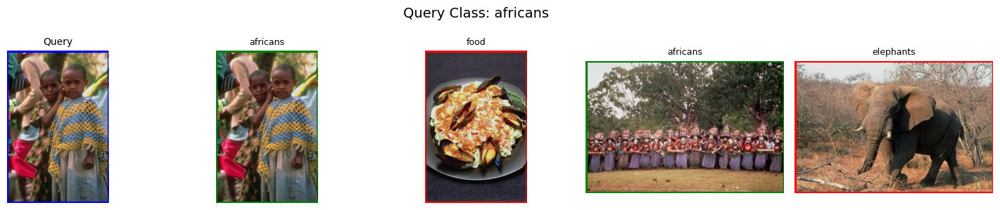


=== Class: beaches ===


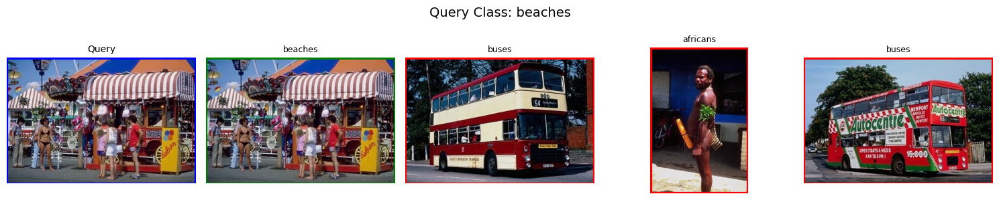


=== Class: buildings ===


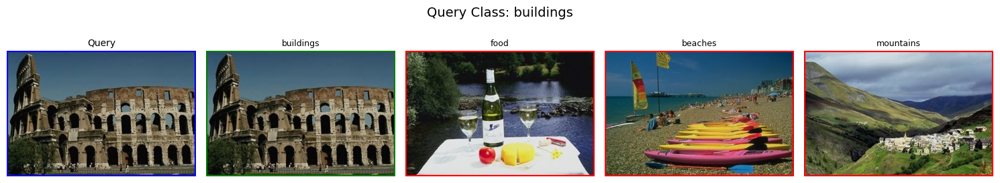


=== Class: buses ===


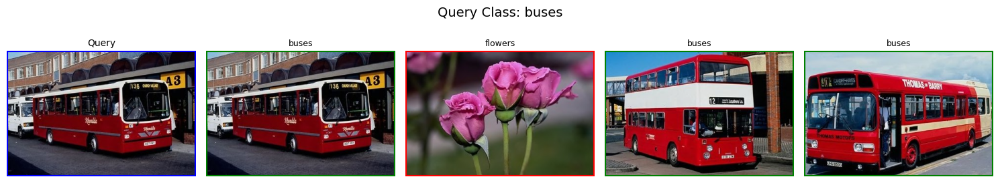


=== Class: dinosaurs ===


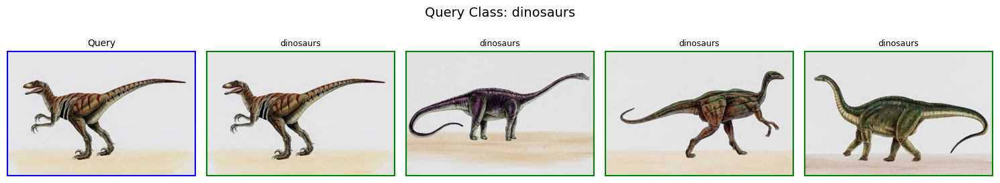


=== Class: elephants ===


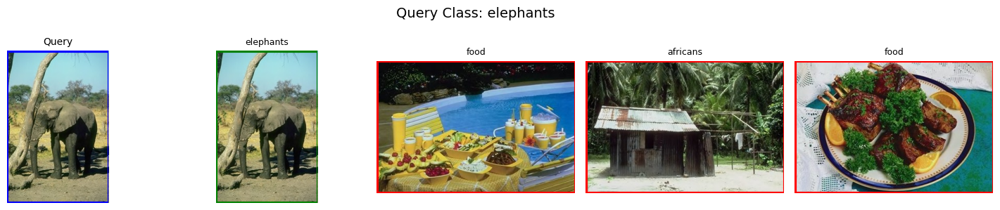


=== Class: flowers ===


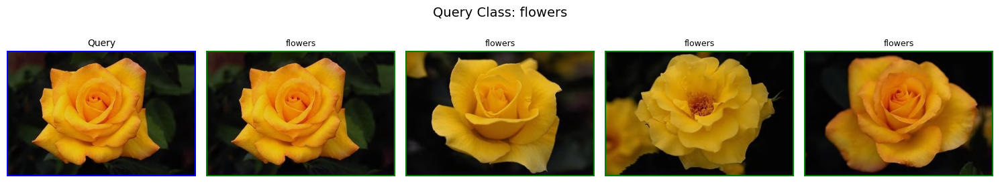


=== Class: food ===


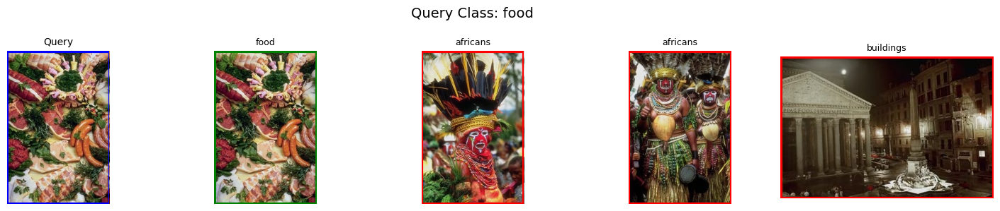


=== Class: horses ===


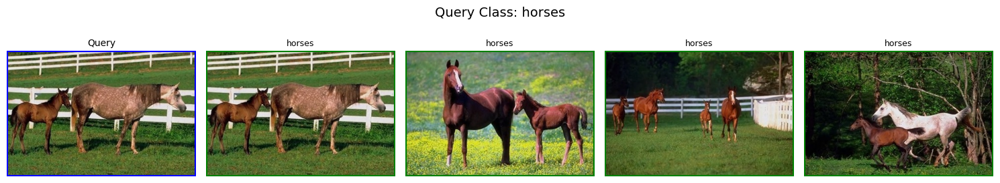


=== Class: mountains ===


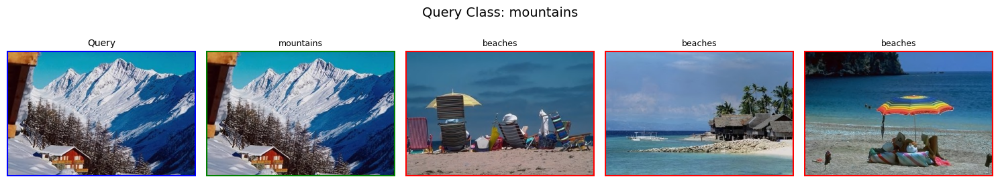

In [23]:
features_cl_glcm = np.hstack([cl_features, glcm_features])
show_topk_per_class(features_cl_glcm, labels, img_paths, top_k=4)



=== Class: africans ===


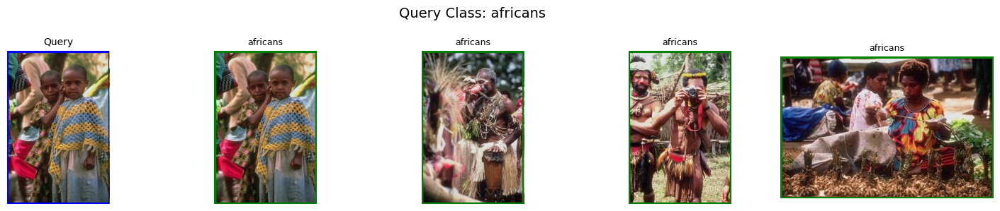


=== Class: beaches ===


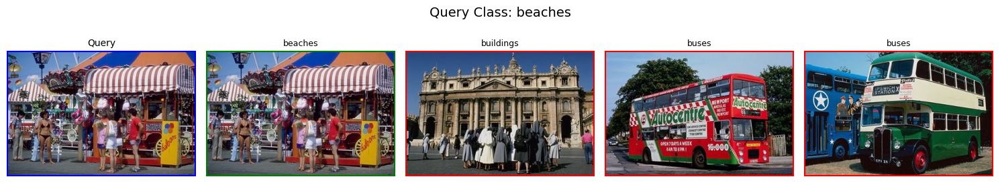


=== Class: buildings ===


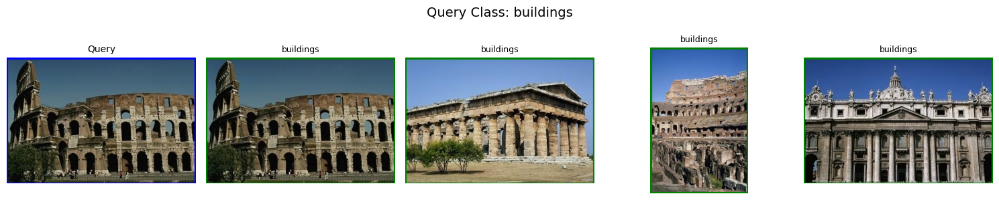


=== Class: buses ===


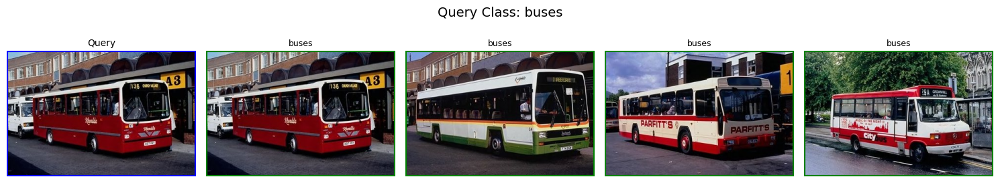


=== Class: dinosaurs ===


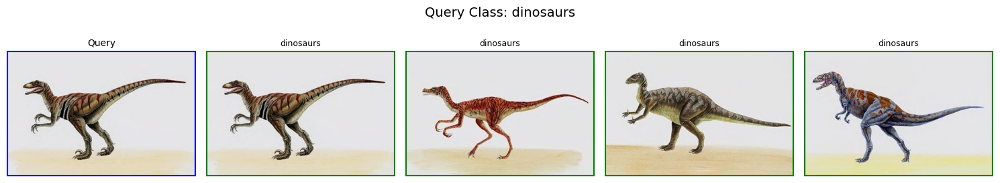


=== Class: elephants ===


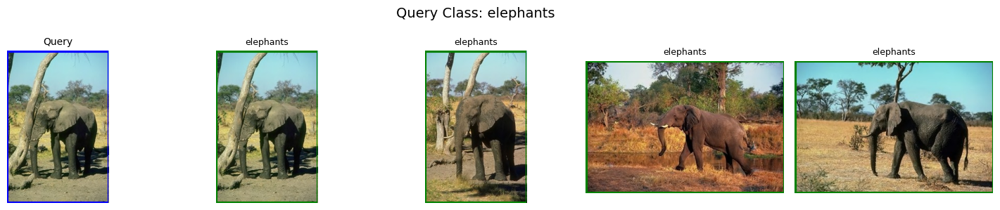


=== Class: flowers ===


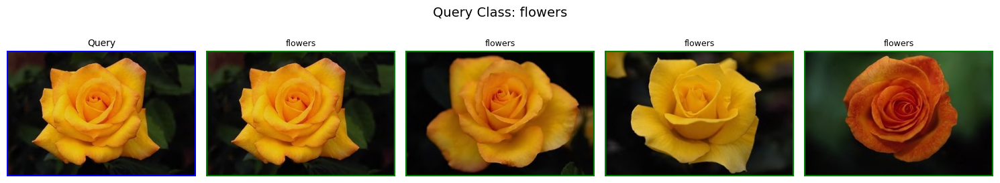


=== Class: food ===


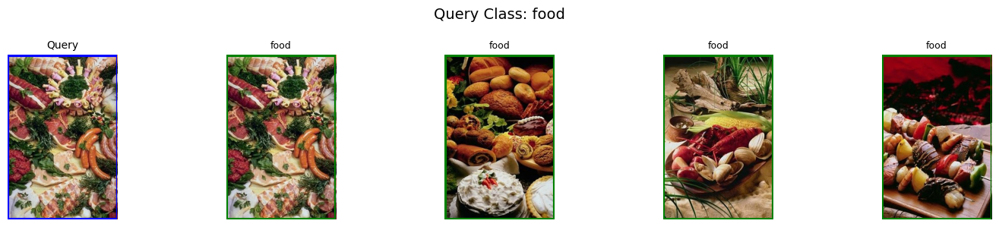


=== Class: horses ===


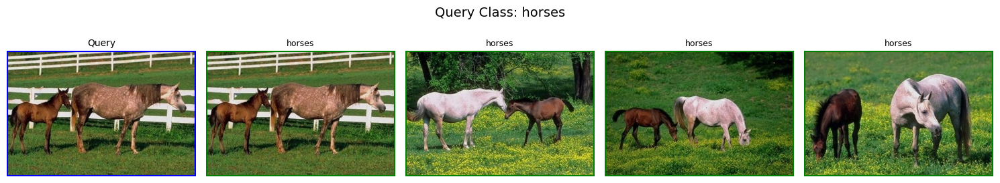


=== Class: mountains ===


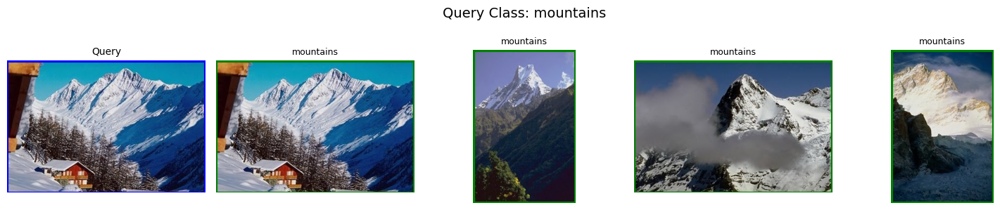

In [24]:
show_topk_per_class(squeezenet_features, labels, img_paths, top_k=4)



=== Class: africans ===


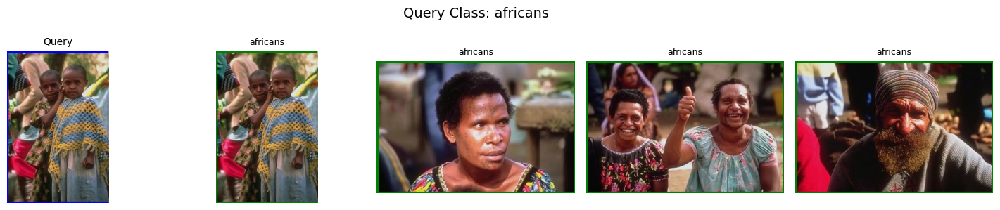


=== Class: beaches ===


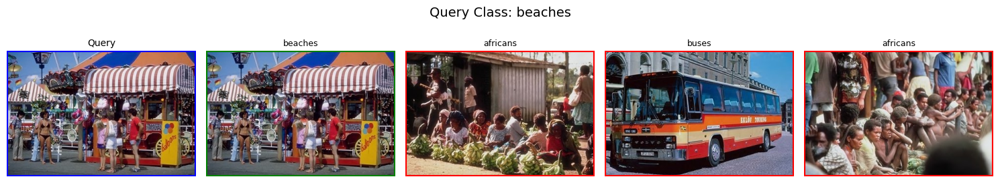


=== Class: buildings ===


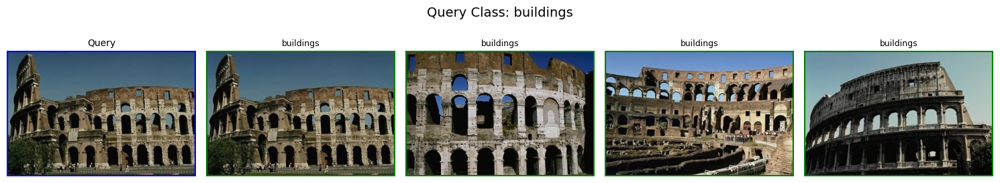


=== Class: buses ===


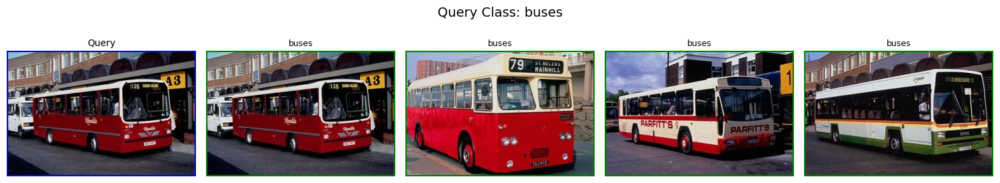


=== Class: dinosaurs ===


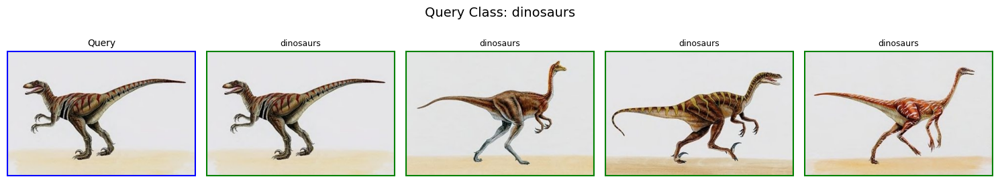


=== Class: elephants ===


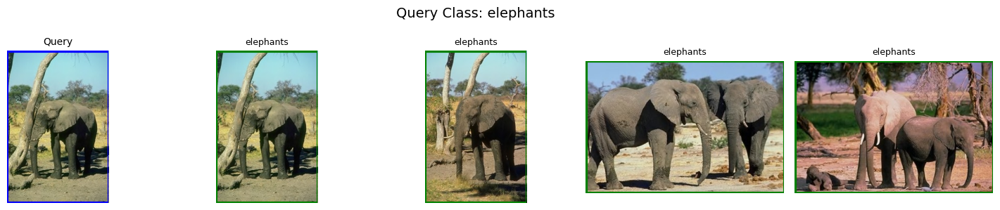


=== Class: flowers ===


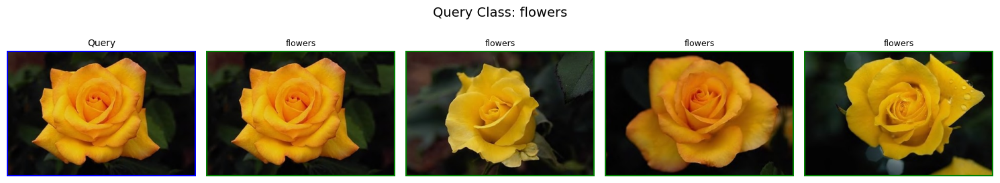


=== Class: food ===


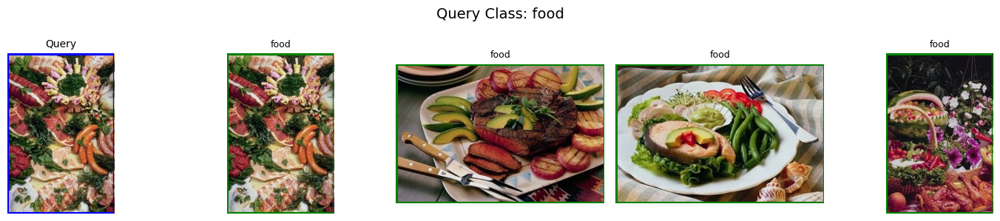


=== Class: horses ===


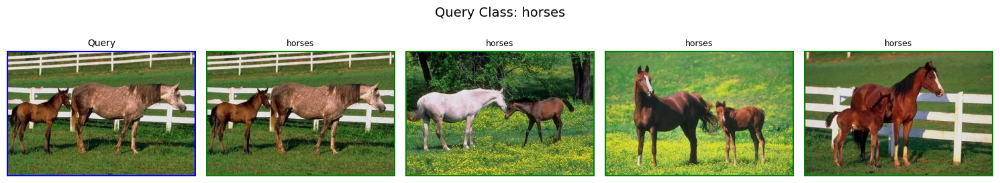


=== Class: mountains ===


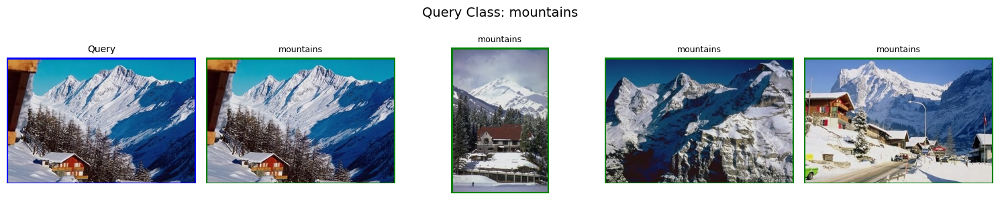

In [25]:
show_topk_per_class(resnet18_features, labels, img_paths, top_k=4)


# B. Dataset GHIM-10K

## Tahap 1: Ekstraksi Fitur Menggunakan Deskriptor Tradisional (Color Layout & GLCM) dan Model CNN Pre-trained (SqueezeNet & ResNet18)

In [3]:
# GLCM Custom
def extract_glcm_features(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (64,64))
    img = (img / 32).astype(np.uint8)
    levels = 8
    glcm = np.zeros((levels, levels), dtype=np.float32)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]-1):
            row = img[i,j]
            col = img[i,j+1]
            glcm[row,col] += 1
    glcm = glcm / np.sum(glcm)
    contrast = np.sum(glcm * (np.arange(levels).reshape(-1,1) - np.arange(levels).reshape(1,-1))**2)
    energy = np.sum(glcm**2)
    homogeneity = np.sum(glcm / (1.0 + np.abs(np.arange(levels).reshape(-1,1) - np.arange(levels).reshape(1,-1))))
    correlation = 0
    return np.array([contrast, energy, homogeneity, correlation])

# Color Layout
def extract_color_layout(img_path):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (64,64))
    return img.mean(axis=(0,1))  # mean RGB sebagai proxy fitur CL

# CNN Models
squeezenet = models.squeezenet1_1(pretrained=True).to(device).eval()
resnet18 = models.resnet18(pretrained=True).to(device).eval()

transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])


C:\Users\acer\AppData\Roaming\Python\Python312\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\acer\AppData\Roaming\Python\Python312\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SqueezeNet1_1_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_1_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\acer\AppData\Roaming\Python\Python312\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can al

## Tahap 2: Pre-trained Models

### 1. SqueezeNet – Pre-trained CNNs for Features Extraction

In [4]:
img_paths = []
labels = []

for cls in os.listdir(data_dir_GHIM):
    cls_path = os.path.join(data_dir_GHIM, cls)
    for f in os.listdir(cls_path):
        img_paths.append(os.path.join(cls_path, f))
        labels.append(cls)

squeezenet_features = []

# Ekstraksi fitur SqueezeNet
for path in tqdm(img_paths, desc="Extracting SqueezeNet Features"):
    img = Image.open(path).convert('RGB')
    img_t = transform(img).unsqueeze(0).to(device) # type: ignore

    with torch.no_grad():
        sq_feat = squeezenet.features(img_t)
        sq_feat = torch.flatten(sq_feat, 1)
        squeezenet_features.append(sq_feat.squeeze().cpu().numpy())

squeezenet_features = np.array(squeezenet_features)

Extracting SqueezeNet Features: 100%|██████████| 10016/10016 [07:28<00:00, 22.36it/s]


### 2. ResNet18 – Pre-trained CNNs for Feature Extraction

In [5]:
resnet18_features = []

# Ekstraksi fitur ResNet18
for path in tqdm(img_paths, desc="Extracting ResNet18 Features"):
    img = Image.open(path).convert('RGB')
    img_t = transform(img).unsqueeze(0).to(device) # type: ignore

    with torch.no_grad():
        x = resnet18.conv1(img_t)
        x = resnet18.bn1(x)
        x = resnet18.relu(x)
        x = resnet18.maxpool(x)
        x = resnet18.layer1(x)
        x = resnet18.layer2(x)
        x = resnet18.layer3(x)
        x = resnet18.layer4(x)
        x = resnet18.avgpool(x)        # 512-dim feature
        resnet18_features.append(x.squeeze().cpu().numpy())

resnet18_features = np.array(resnet18_features)

Extracting ResNet18 Features: 100%|██████████| 10016/10016 [02:04<00:00, 80.68it/s]


### 3. Visual Features – Color Layout (CL) & GLCM Texture Descriptors

In [6]:
cl_features = []
glcm_features = []

# Ekstraksi fitur CL & GLCM
for path in tqdm(img_paths, desc="Extracting CL & GLCM Features"):
    # Color Layout
    cl_features.append(extract_color_layout(path))
    # GLCM Texture Features
    glcm_features.append(extract_glcm_features(path))

cl_features = np.array(cl_features)
glcm_features = np.array(glcm_features)


Extracting CL & GLCM Features: 100%|██████████| 10016/10016 [03:32<00:00, 47.15it/s]


## Tahap 3: Image Retrieval & Similarity Matching

In [7]:
# Retrieve indeks gambar paling mirip berdasarkan cosine similarity.
def retrieve(query_feat, all_feats, top_k=10):
    sims = cosine_similarity([query_feat], all_feats)[0] # type: ignore
    idxs = np.argsort(sims)[::-1][:top_k]
    return idxs

def evaluate_recall_precision(features, labels, top_k=10):
    classes = sorted(list(set(labels)))
    results = []
    for cls in classes:
        idxs_cls = [i for i,l in enumerate(labels) if l==cls]
        R_list, P_list = [], []
        for q in idxs_cls:
            retrieved_idx = retrieve(features[q], features, top_k)
            retrieved_labels = [labels[i] for i in retrieved_idx]
            R = retrieved_labels.count(cls) / len(idxs_cls)
            P = retrieved_labels.count(cls) / top_k
            R_list.append(R)
            P_list.append(P)
        results.append([cls, np.mean(R_list), np.mean(P_list)])
    return pd.DataFrame(results, columns=['Class','R','P'])

## Tahap 4: Evaluasi

In [10]:
df_cl_glcm = evaluate_recall_precision(np.hstack([cl_features, glcm_features]), labels)
df_squeeze = evaluate_recall_precision(squeezenet_features, labels)
df_resnet = evaluate_recall_precision(resnet18_features, labels)

df_table = pd.DataFrame()
df_table['Class'] = df_cl_glcm['Class']

df_table['CL&GLCM R'] = df_cl_glcm['R']
df_table['CL&GLCM P'] = df_cl_glcm['P']

df_table['SqueezeNet R'] = df_squeeze['R']
df_table['SqueezeNet P'] = df_squeeze['P']

df_table['ResNet18 R'] = df_resnet['R']
df_table['ResNet18 P'] = df_resnet['P']

# MEAN
mean_row = {
    'Class': 'Mean',
    'CL&GLCM R': df_cl_glcm['R'].mean(),
    'CL&GLCM P': df_cl_glcm['P'].mean(),
    'SqueezeNet R': df_squeeze['R'].mean(),
    'SqueezeNet P': df_squeeze['P'].mean(),
    'ResNet18 R': df_resnet['R'].mean(),
    'ResNet18 P': df_resnet['P'].mean(),
}

df_table = pd.concat([df_table, pd.DataFrame([mean_row])], ignore_index=True)

for col in df_table.columns[1:]:
    df_table[col] = df_table[col].astype(float).map("{:.4f}".format)

display(df_table)

,Class,CL&GLCM R,CL&GLCM P,SqueezeNet R,SqueezeNet P,ResNet18 R,ResNet18 P
0,aircraft,0.0045,0.2240,0.0172,0.8590,0.0196,0.9824
1,buildings,0.0051,0.2538,0.0169,0.8466,0.0194,0.9696
2,butterfly,0.0052,0.2624,0.0156,0.7798,0.0194,0.9722
3,cars,0.0045,0.2226,0.0193,0.9638,0.0198,0.9912
4,dragon fly,0.0055,0.2744,0.0169,0.8432,0.0193,0.9640
5,fireworks,0.0092,0.4616,0.0198,0.9890,0.0199,0.9962
6,flowers,0.0051,0.2570,0.0190,0.9486,0.0200,0.9982
7,hen,0.0048,0.2396,0.0181,0.9066,0.0200,0.9992
8,horses,0.0045,0.2244,0.0186,0.9312,0.0197,0.9848
9,insects,0.0067,0.3340,0.0135,0.6758,0.0181,0.9072


Processing CL & GLCM |=---------------------------------------| 3%

Processing ResNet18 |========================================| 100%%


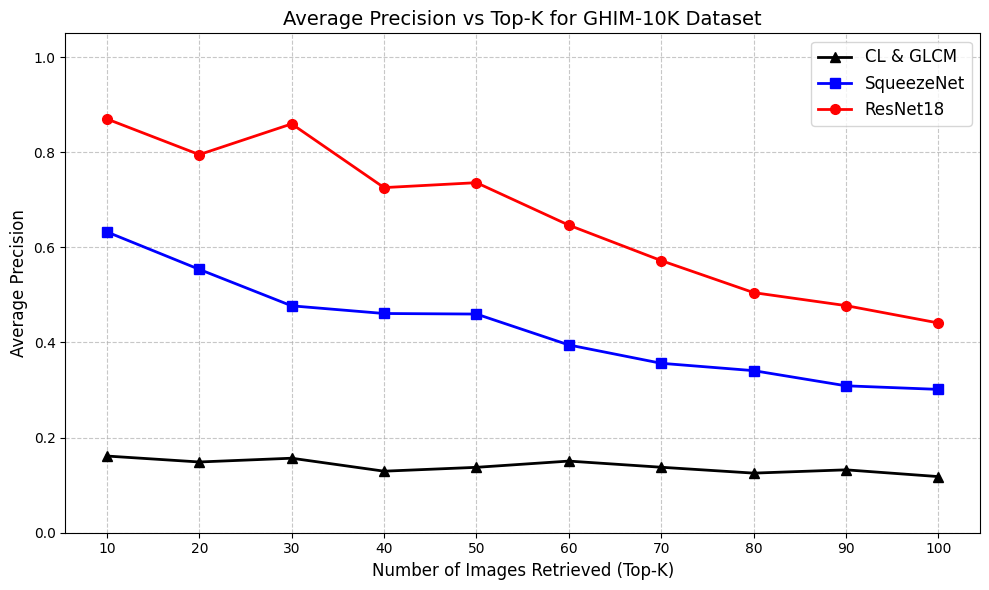

In [14]:
def to_numpy(feats):
    feats = np.array(feats)
    if feats.ndim == 1:
        feats = feats.reshape(1, -1)
    return feats.astype(np.float32)

def safe_sample(features, labels, max_samples=1000):
    features = to_numpy(features)
    labels = np.array(labels)

    N = len(features)
    if max_samples is None or N <= max_samples:
        return features, labels

    idx = np.random.choice(N, max_samples, replace=False)
    return features[idx], labels[idx]

def fast_avg_precision(features, labels, top_k=100, query_n=80):
    features = to_numpy(features)
    labels = np.array(labels)

    N = len(features)
    q_idx = np.random.choice(N, min(query_n, N), replace=False)

    prec_list = []

    for qi in q_idx:
        q = features[qi:qi+1]
        sims = cosine_similarity(q, features)[0]

        sims[qi] = -1
        idx = np.argpartition(sims, -top_k)[-top_k:]
        idx = idx[np.argsort(sims[idx])[::-1]]

        retrieved = labels[idx]
        rel = (retrieved == labels[qi]).sum()

        prec_list.append(rel / top_k)

    return np.mean(prec_list)

def progress_bar(i, total, prefix=""):
    percent = int(i / total * 100)
    bar_len = 40
    filled = int(bar_len * percent / 100)
    bar = "=" * filled + "-" * (bar_len - filled)
    sys.stdout.write(f"\r{prefix} |{bar}| {percent}%")
    sys.stdout.flush()
    if i == total:
        print()

def average_precision_vs_topk(features_list, labels, top_k_max=100):
    top_ks = list(range(10, top_k_max + 1, 10))
    avg_prec = {name: [] for name in features_list}
    
    total_steps = len(features_list) * len(top_ks)
    step = 0

    markers = {
        'ResNet18': 'o',
        'SqueezeNet': 's',
        'CL & GLCM': '^'
    }

    colors = {
        'ResNet18': 'red',
        'SqueezeNet': 'blue',
        'CL & GLCM': 'black'
    }

    # LOOP EVALUASI
    for name, feats in features_list.items():
        feats_s, labels_s = safe_sample(feats, labels)

        for top_k in top_ks:
            step += 1
            progress_bar(step, total_steps, prefix=f"Processing {name}")

            p = fast_avg_precision(feats_s, labels_s, top_k=top_k)
            avg_prec[name].append(p)

    plt.figure(figsize=(10, 6))

    for name in features_list:
        plt.plot(top_ks, avg_prec[name],
                 marker=markers[name],
                 color=colors[name],
                 linestyle='-',
                 linewidth=2,
                 markersize=7,
                 label=name)

    plt.xlabel("Number of Images Retrieved (Top-K)", fontsize=12)
    plt.ylabel("Average Precision", fontsize=12)
    plt.title("Average Precision vs Top-K for GHIM-10K Dataset", fontsize=14)
    plt.xticks(top_ks)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12)
    plt.ylim(0, 1.05)
    plt.tight_layout()
    plt.show()


features_dict = {
    "CL & GLCM": np.hstack([cl_features, glcm_features]),
    "SqueezeNet": squeezenet_features,
    "ResNet18": resnet18_features
}

average_precision_vs_topk(features_dict, labels, top_k_max=100)


In [15]:
def show_topk_per_class(features, labels, img_paths, top_k=4):
    classes = sorted(list(set(labels)))

    for cls in classes:
        print(f"\n=== Class: {cls} ===")

        # Mengambil index pertama dari kelas sebagai query
        query_idx = labels.index(cls)

        # Retrieve top-k hasil
        retrieved_idx = retrieve(features[query_idx], features, top_k)

        plt.figure(figsize=(15, 3))
        plt.suptitle(f"Query Class: {cls}", fontsize=14)

        query_img = Image.open(img_paths[query_idx])
        plt.subplot(1, top_k + 1, 1)
        plt.imshow(query_img)
        plt.axis('off')
        plt.title("Query", fontsize=10)
        plt.gca().add_patch(patches.Rectangle((0,0), query_img.width, query_img.height,
                                              edgecolor='blue', fill=False, linewidth=3))

        for i, idx in enumerate(retrieved_idx):
            img = Image.open(img_paths[idx])
            plt.subplot(1, top_k + 1, i + 2)
            plt.imshow(img)
            plt.axis('off')
            color = 'green' if labels[idx] == cls else 'red'
            plt.gca().add_patch(patches.Rectangle((0,0), img.width, img.height,
                                                  edgecolor=color, fill=False, linewidth=3))
            plt.title(labels[idx], fontsize=9)

        plt.tight_layout()
        plt.show()


=== Class: aircraft ===


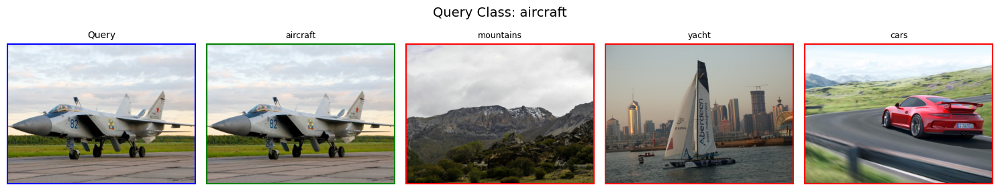


=== Class: buildings ===


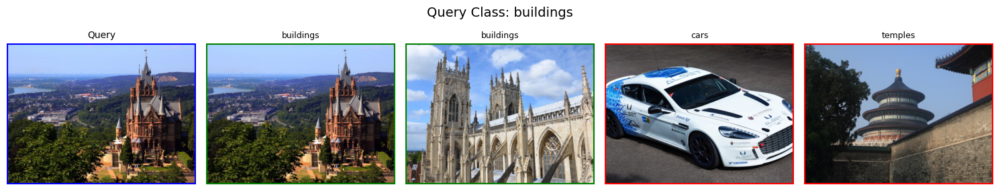


=== Class: butterfly ===


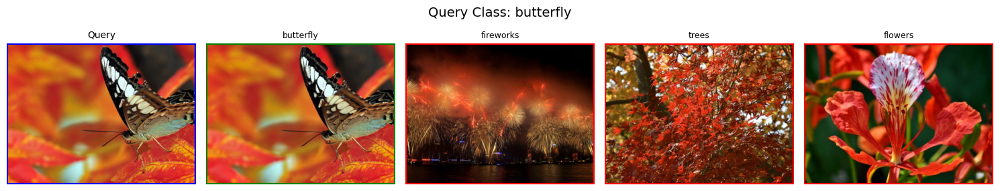


=== Class: cars ===


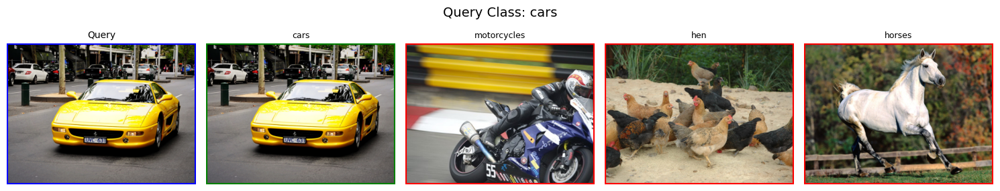


=== Class: dragon fly ===


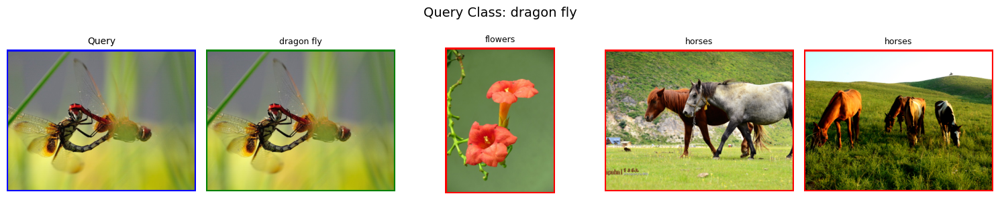


=== Class: fireworks ===


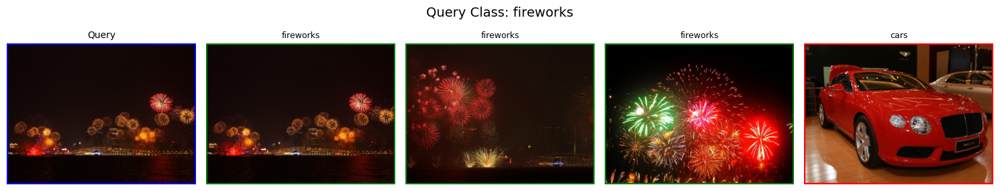


=== Class: flowers ===


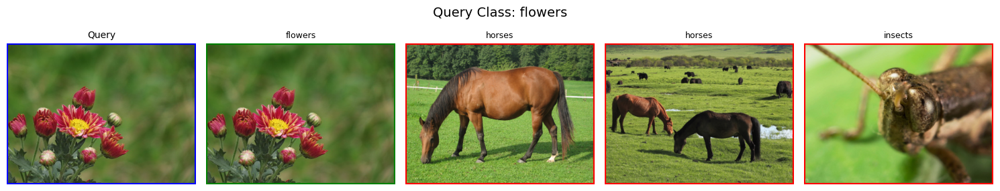


=== Class: hen ===


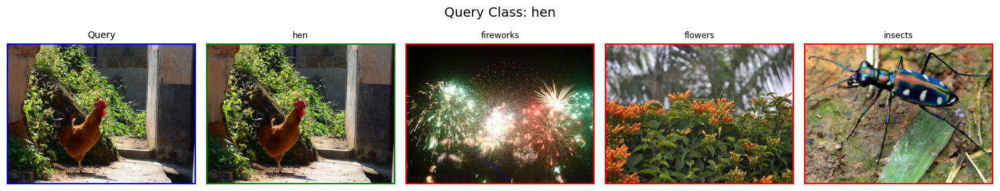


=== Class: horses ===


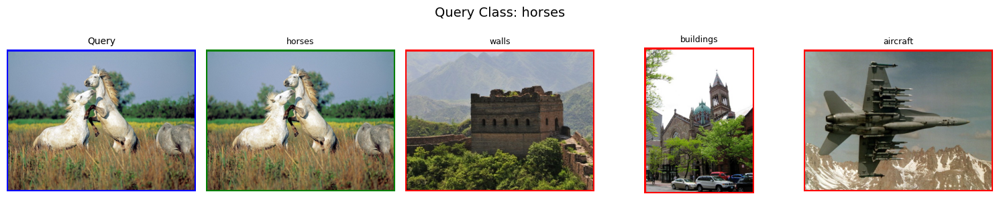


=== Class: insects ===


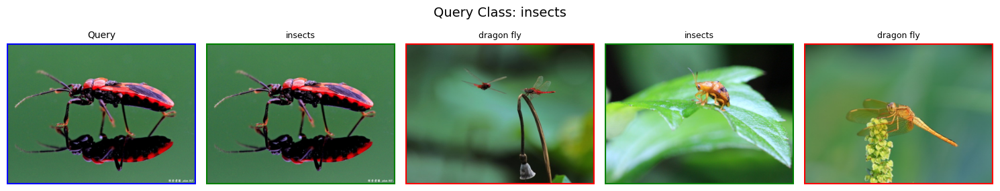


=== Class: motorcycles ===


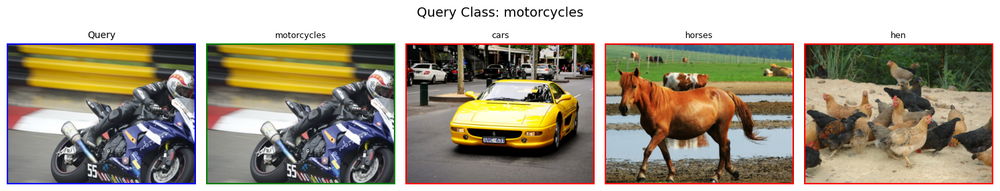


=== Class: mountains ===


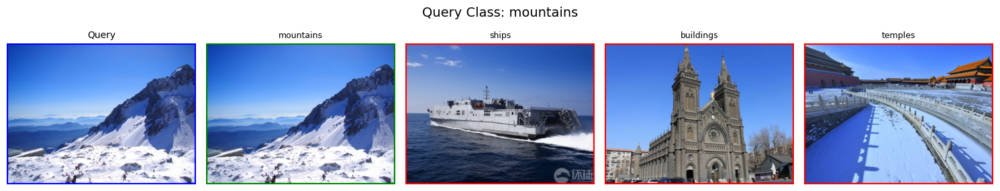


=== Class: sea shores ===


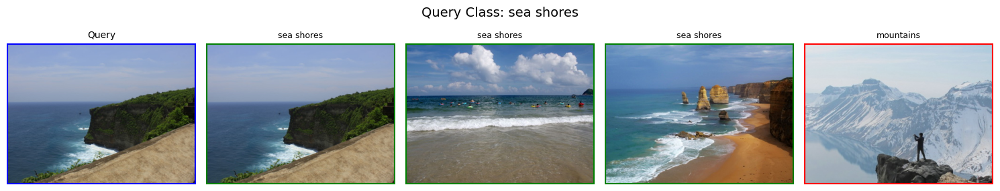


=== Class: ships ===


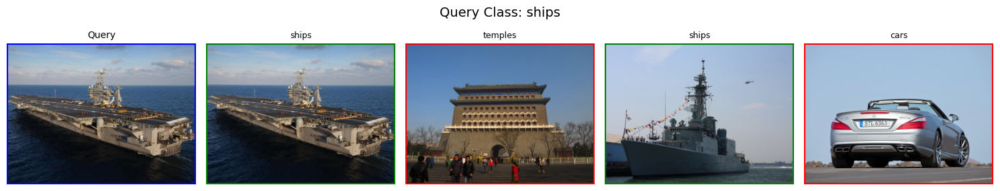


=== Class: sunset ===


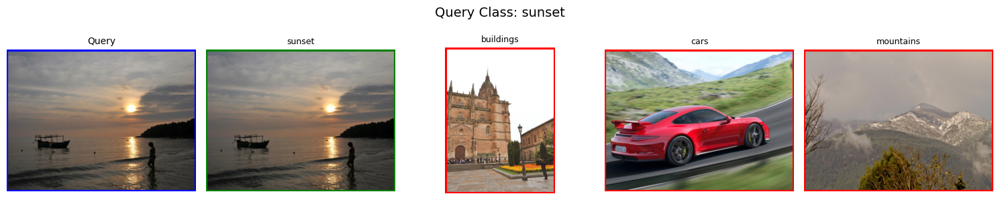


=== Class: temples ===


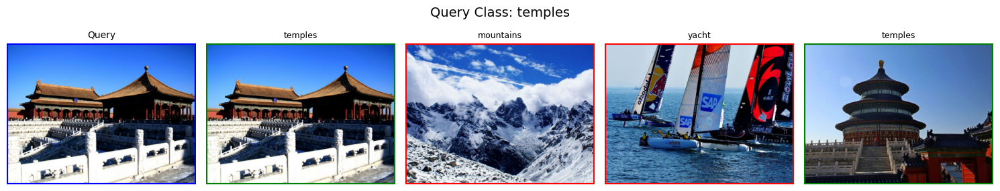


=== Class: trees ===


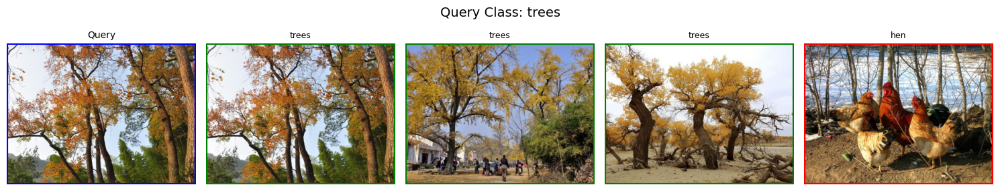


=== Class: valleys ===


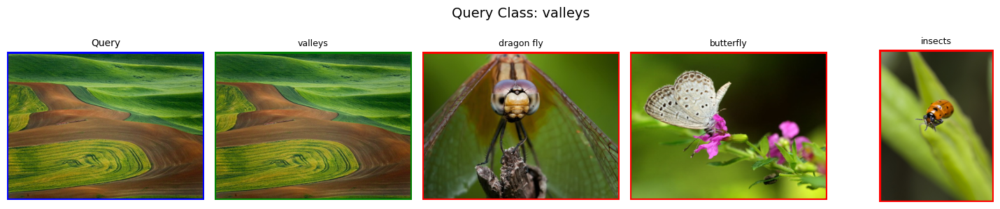


=== Class: walls ===


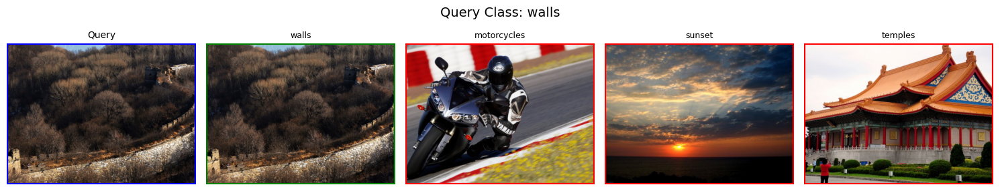


=== Class: yacht ===


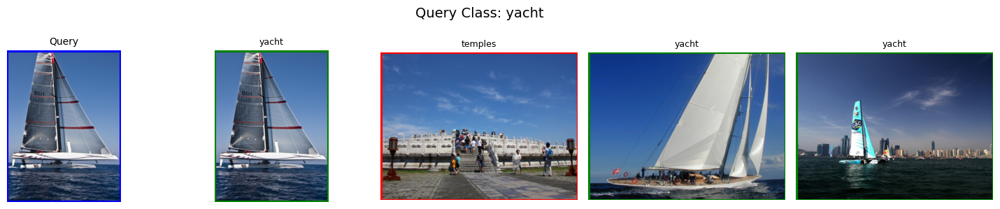

In [16]:
show_topk_per_class(np.hstack([cl_features, glcm_features]), labels, img_paths, top_k=4)


=== Class: aircraft ===


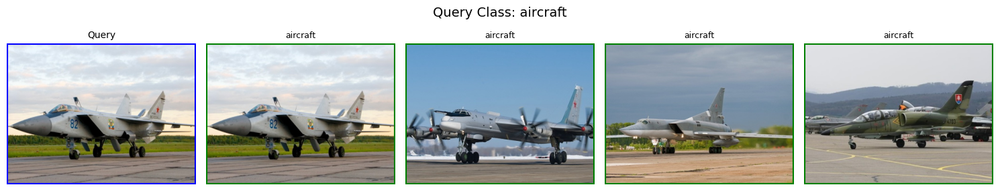


=== Class: buildings ===


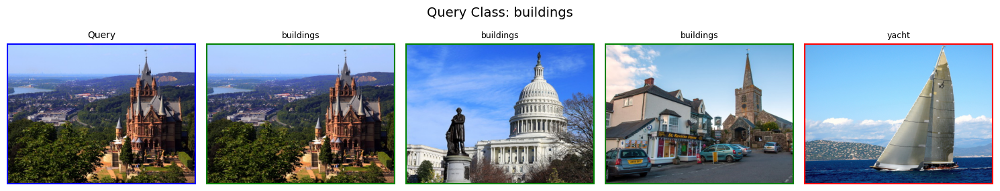


=== Class: butterfly ===


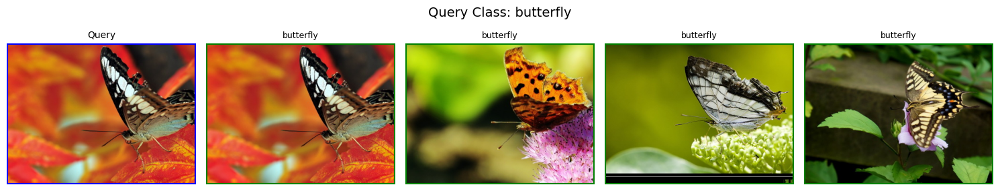


=== Class: cars ===


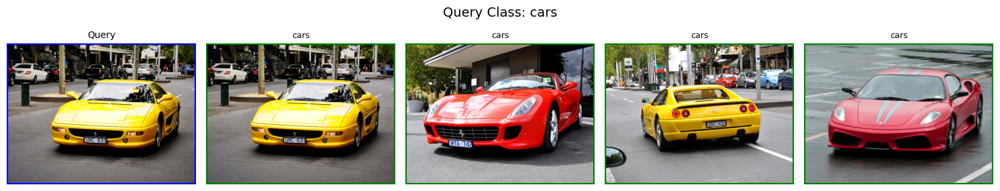


=== Class: dragon fly ===


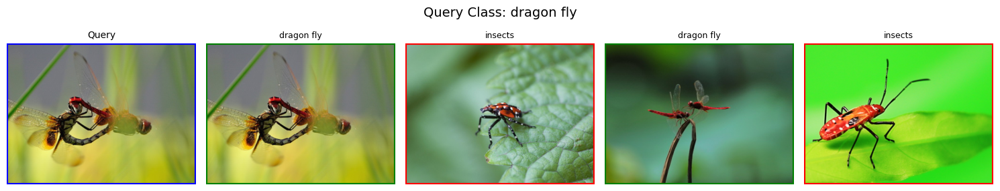


=== Class: fireworks ===


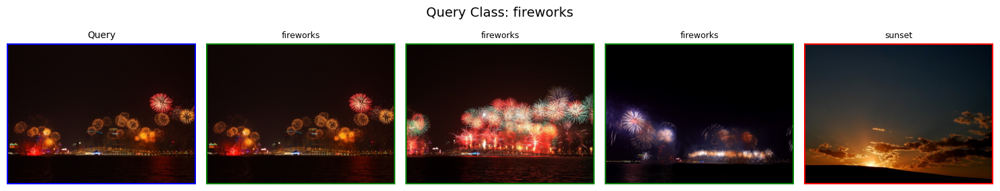


=== Class: flowers ===


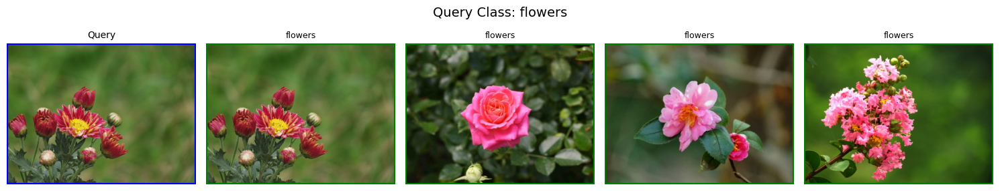


=== Class: hen ===


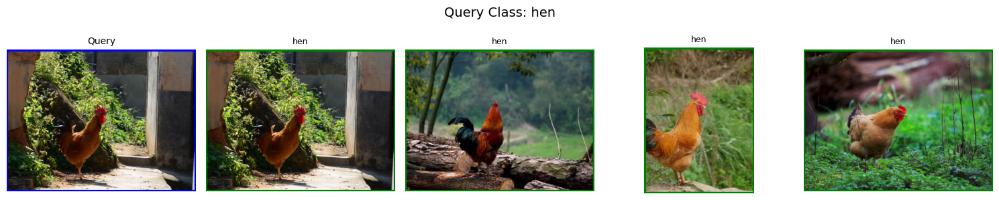


=== Class: horses ===


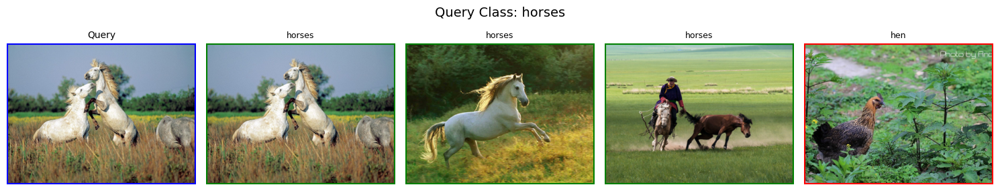


=== Class: insects ===


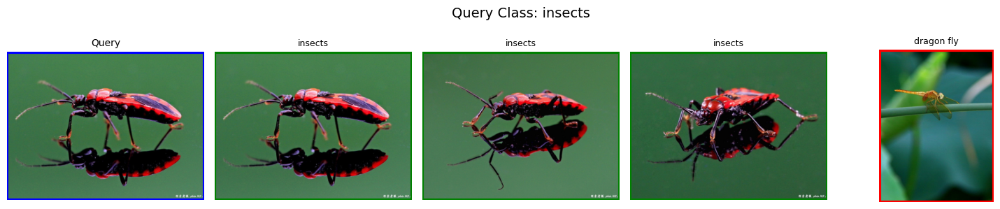


=== Class: motorcycles ===


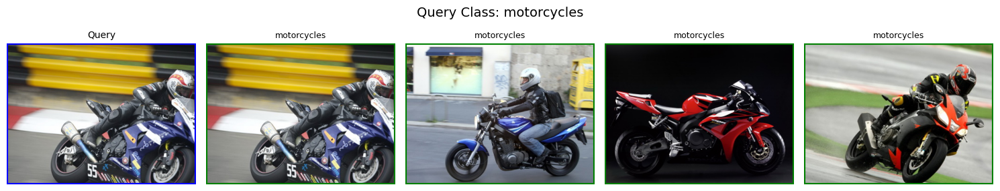


=== Class: mountains ===


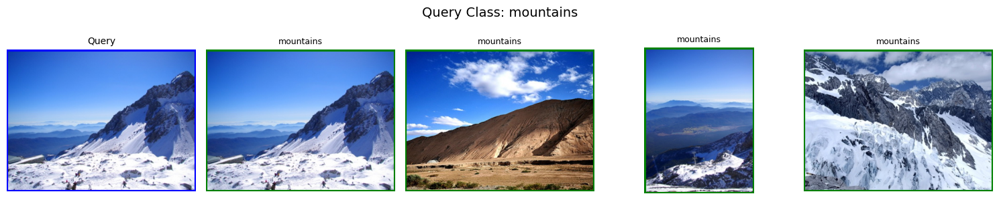


=== Class: sea shores ===


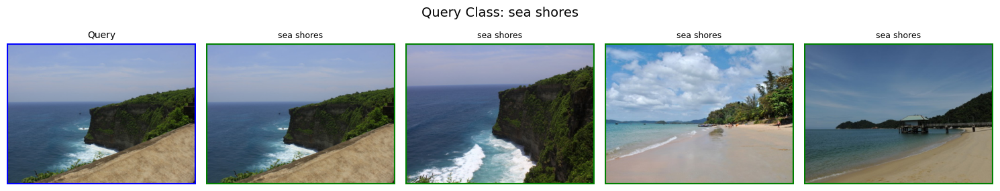


=== Class: ships ===


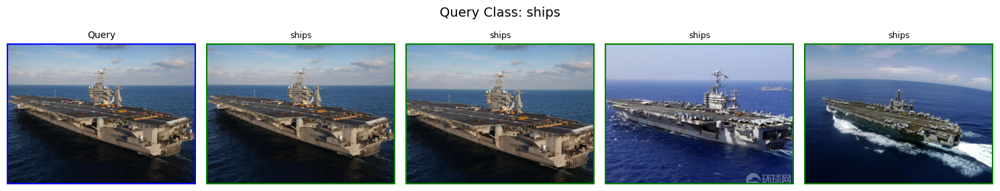


=== Class: sunset ===


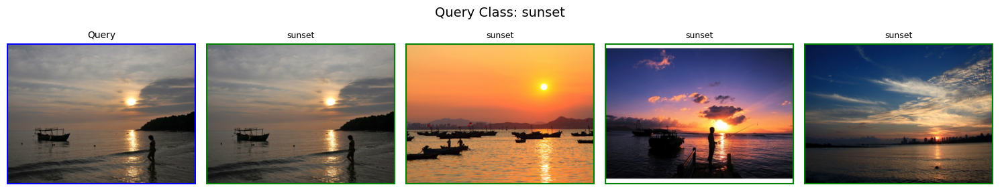


=== Class: temples ===


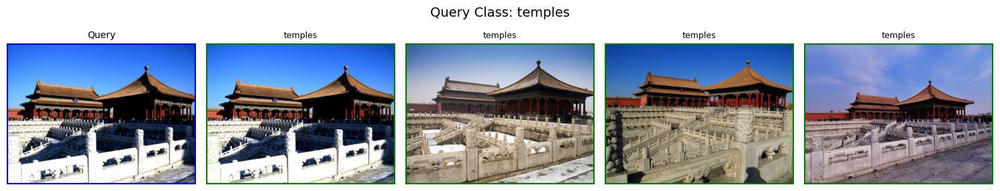


=== Class: trees ===


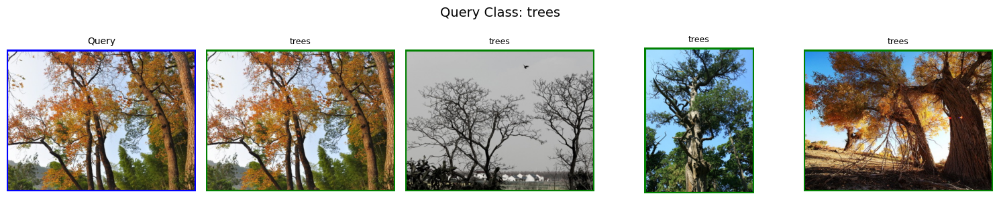


=== Class: valleys ===


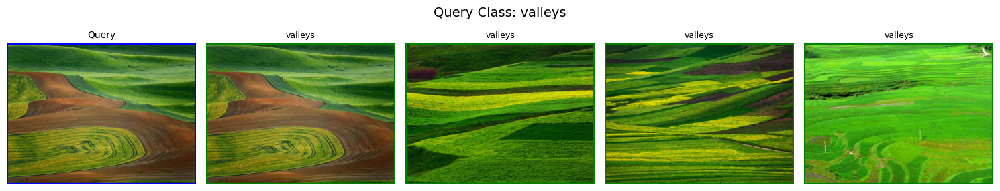


=== Class: walls ===


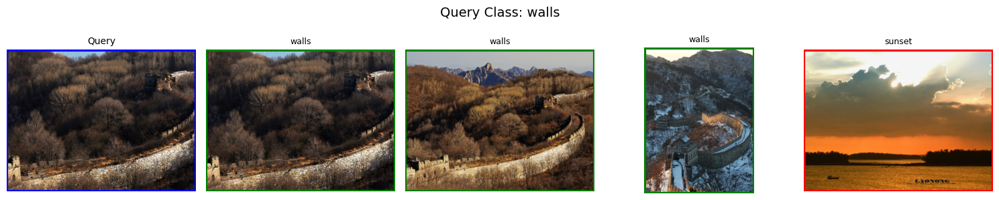


=== Class: yacht ===


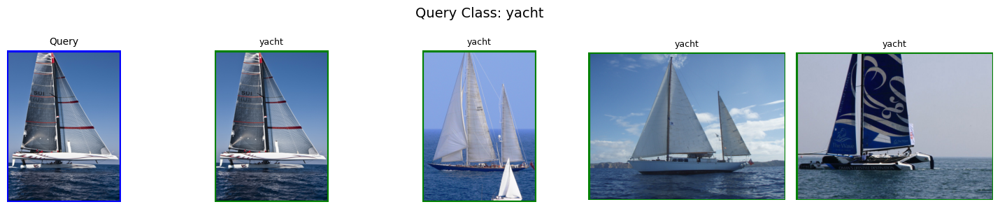

In [21]:
show_topk_per_class(squeezenet_features, labels, img_paths, top_k=4)


=== Class: aircraft ===


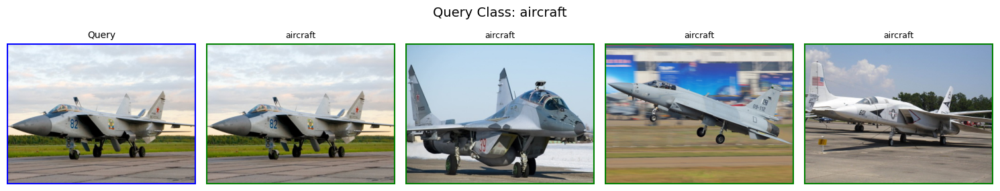


=== Class: buildings ===


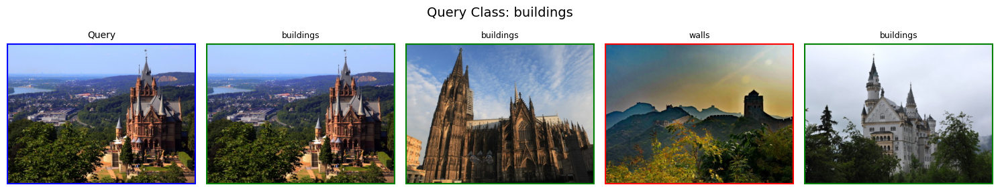


=== Class: butterfly ===


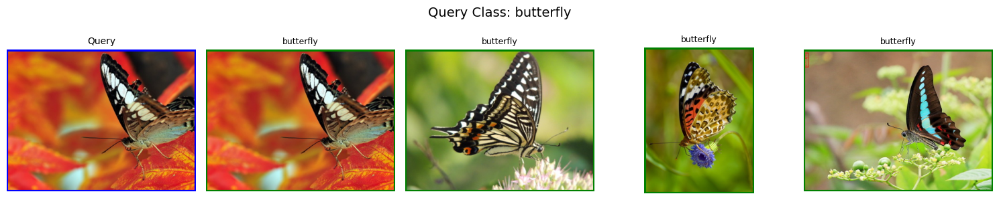


=== Class: cars ===


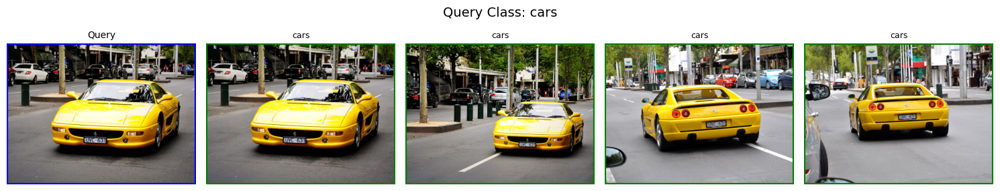


=== Class: dragon fly ===


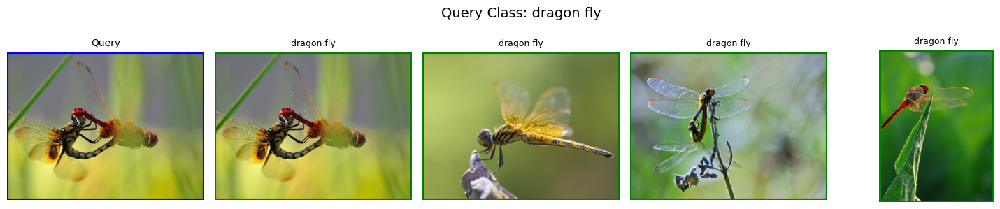


=== Class: fireworks ===


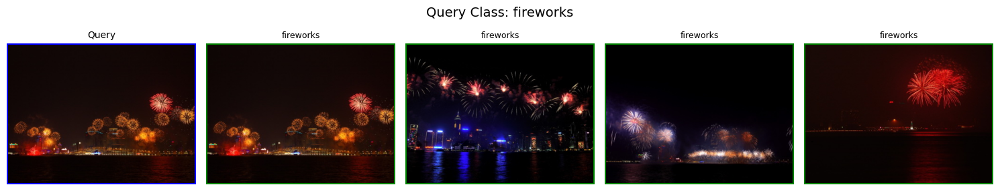


=== Class: flowers ===


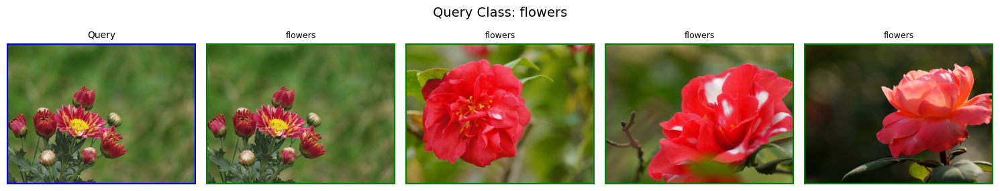


=== Class: hen ===


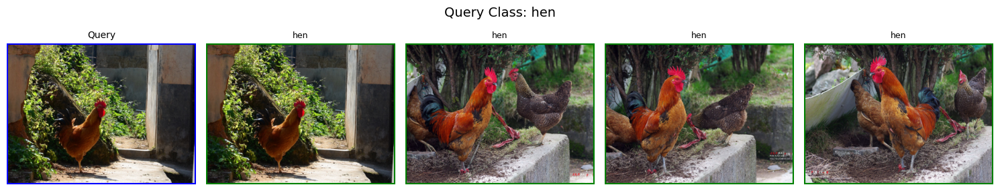


=== Class: horses ===


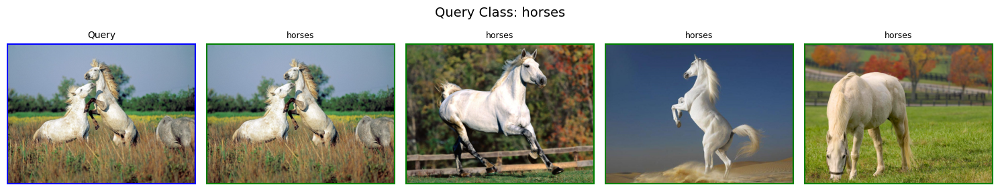


=== Class: insects ===


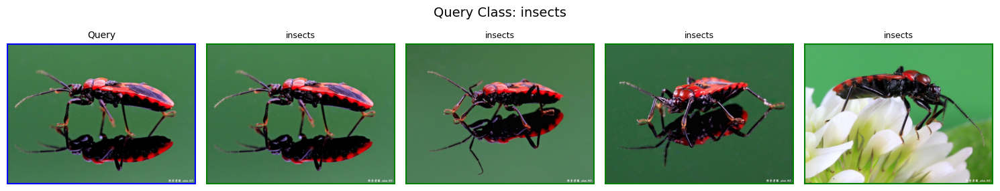


=== Class: motorcycles ===


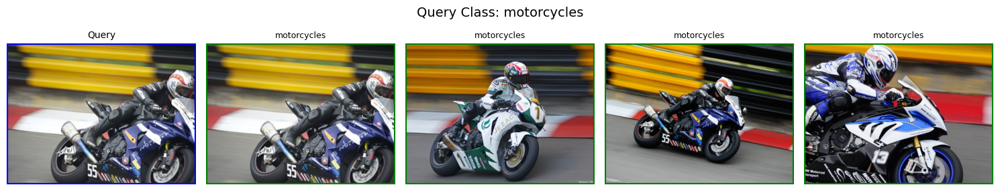


=== Class: mountains ===


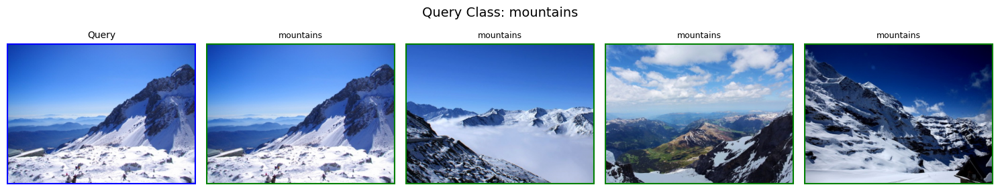


=== Class: sea shores ===


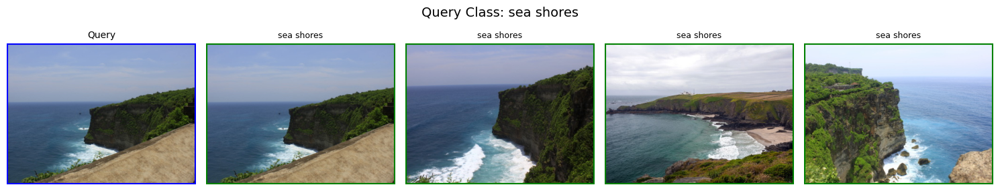


=== Class: ships ===


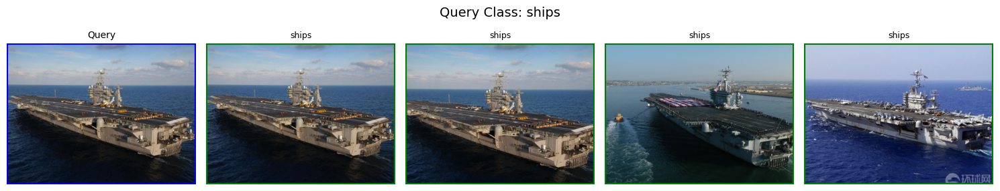


=== Class: sunset ===


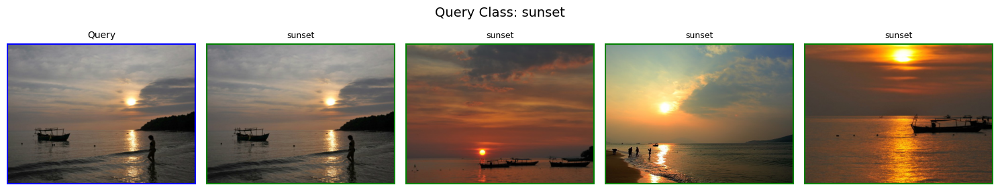


=== Class: temples ===


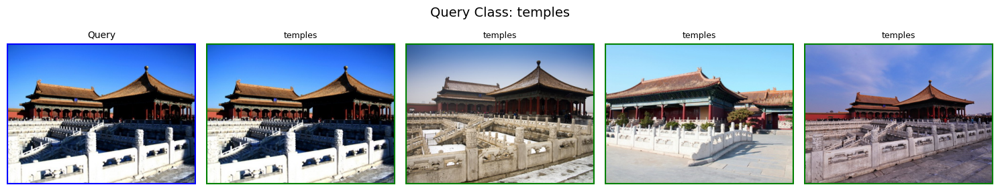


=== Class: trees ===


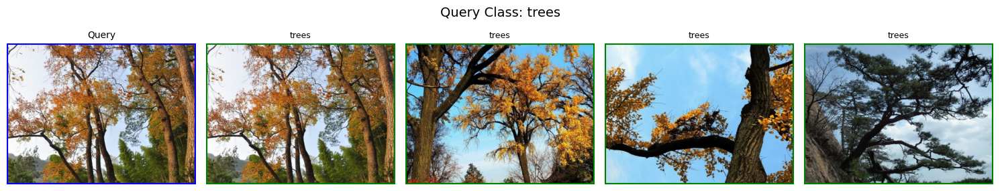


=== Class: valleys ===


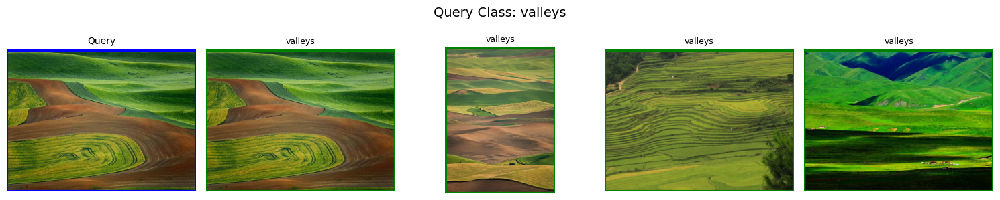


=== Class: walls ===


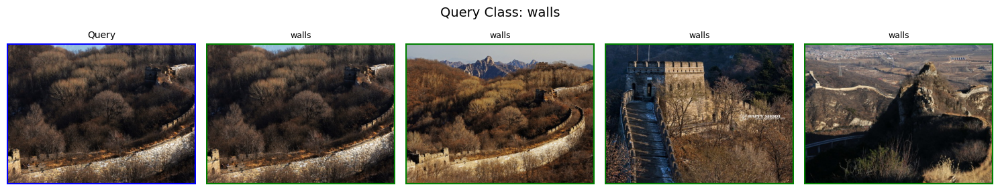


=== Class: yacht ===


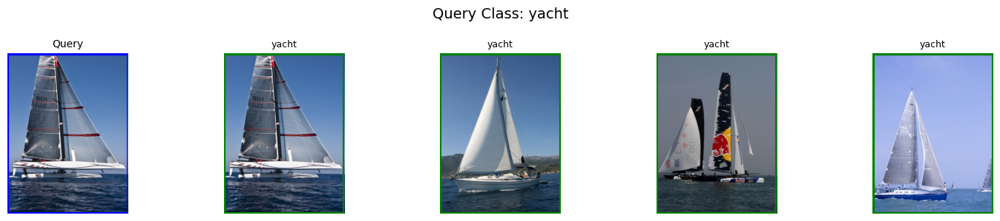

In [17]:
show_topk_per_class(resnet18_features, labels, img_paths, top_k=4)